  * This notebook was made to look at a big picture of surface currents in the plume area with CODAR data, aiming to get some insights of the currents besides line or point comparison.

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import netCDF4 as nc
import numpy as np
import datetime
import scipy.io as sio
import os
import matplotlib.colors as mcolors
import matplotlib.gridspec as gridspec
from salishsea_tools import nc_tools, viz_tools, tidetools, stormtools, bathy_tools
from __future__ import division
from matplotlib import animation

In [2]:
ferry_stations = {'Tsawwassen': {'lat': 49.0084,'lon': -123.1281},
                  'Duke': {'lat': 49.1632,'lon': -123.8909}}

In [3]:
grid6 = nc.Dataset('/ocean/jieliu/research/meopar/river-treatment/bathy_meter_SalishSea6.nc')
X = grid6.variables['nav_lon'][:, :]
Y = grid6.variables['nav_lat'][:, :]
bathy = grid6.variables['Bathymetry'][:, :]
grid10 = nc.Dataset('/ocean/jieliu/research/meopar/river-treatment/bathy_meter_SalishSea10.nc')

In [4]:
## load data
codar = sio.loadmat('/ocean/jieliu/research/meopar/salinity_comparison/SoG_radar_totals.mat')
t = codar['mtime']
lat_codar = codar['glat']
lon_codar = codar['glon']
u = codar['u']
v = codar['v']

In [5]:
## initialize the start_time and determine run_time
start_time = datetime.datetime(2014, 10, 8,0)
run_time = datetime.datetime(2014, 10, 8, 0)

In [6]:
from datetime import timedelta
def python_time(run_time):
    run_upper = run_time.replace(minute = 30)
    if run_time.hour != 0:
        run_lower = run_time.replace(hour = run_time.hour-1, minute = 30)
    else:
        run_lower = run_time.replace(day = run_time.day -1,hour =23, minute=30)
    for i,tt  in enumerate(np.arange(0,len(t))):
        matlab_datenum = np.float(t[i])
        python_datetime = datetime.datetime.fromordinal(int(matlab_datenum))\
        + timedelta(days=matlab_datenum%1) - timedelta(days = 366)
        if (python_datetime > run_lower)&(python_datetime < run_upper):
            return python_datetime, i

In [7]:
#subset
ist=1
ien=398
jst=1
jen=898
x=np.arange(ist,ien)
y=np.arange(jst,jen)
st=3
cmin, cmax, dels = -6, 6, 0.6

In [8]:
def seek_ferry_time(ax,run_time, value_flag=True):
    """if value_flag =true, it returns only minimum ferry
       salinity value and location, else, it returns plot,
       if not within ferry running time, return None"""
    
    directory = '/ocean/jieliu/research/meopar/autodataupdate/ferrydata/';
    base = 'SBE19'
    if run_time.hour ==0 or run_time.hour ==3 or run_time.hour ==5:
        path = os.path.join(directory,'{}'.format(base)+\
                run_time.replace(day = run_time.day -1).strftime('%Y%m%d')+'.mat')
    elif run_time.hour == 12 or run_time.hour ==14 or run_time.hour ==16 or \
        run_time.hour ==19 or run_time.hour ==21:
        path = os.path.join(directory,'{}'.format(base)+\
                run_time.replace(day = run_time.day ).strftime('%Y%m%d')+'.mat')
    else:
        path = []
    if path!= []:
        saline = sio.loadmat(path)
        dataa = saline['ferryData']['data'][0,0]
        time=dataa['matlabtime'][0,0]
        lonn=dataa['Longitude'][0,0]
        latt=dataa['Latitude'][0,0]
        salinity=dataa['Practical_Salinity'][0,0]
        
        a=len(time)
        lon1=np.zeros([a,1])
        lat1=np.zeros([a,1])
        salinity1=np.zeros([a,1])
        if run_time.hour ==3 or run_time.hour ==5 or run_time.hour ==12 or run_time.hour ==19:
            run_lower = run_time.replace( minute = 15)#!!more convenient than day,miniute..
            run_upper = run_time.replace(hour= run_time.hour + 2, minute=45)
        else:
            run_lower = run_time.replace( minute = 45)
            if run_time.hour ==16 or run_time.hour ==0:
                run_upper = run_time.replace(hour= run_time.hour + 3, minute=15)
            elif run_time.hour == 21:
                 run_upper = run_time.replace(day = run_time.day +1, hour=0, minute=45)    
            else:
                run_upper = run_time.replace(hour=run_time.hour + 2, minute=45)
        for i in np.arange(0,a):
            matlab_datenum = np.float(time[i])
            python_datetime = datetime.datetime.fromordinal(int(matlab_datenum))\
            + timedelta(days=matlab_datenum%1) - timedelta(days = 366)

            if (python_datetime >= run_lower) &(python_datetime <= run_upper):
                lon1[i]=lonn[i]
                lat1[i]=latt[i]
                salinity1[i]=salinity[i]
        mask=lon1[:,0]!=0
        lon1_2_4=lon1[mask]
        lat1_2_4=lat1[mask]
        salinity1_2_4=salinity1[mask]
        
        if value_flag:## just return salinity and location
            return lon1_2_4, lat1_2_4, salinity1_2_4
        else:
            ##plot    
            cm = plt.cm.get_cmap('spectral',12)
            sc = ax.scatter(lon1_2_4, lat1_2_4, c = salinity1_2_4,\
               edgecolor ='', vmin =10,vmax = 30, s =30, cmap = cm)
            cbar = plt.colorbar(sc, ax=ax)
            plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='k', fontsize = 20)
            cbar.set_label('Practical Salinity', fontsize = 20)
            return sc
    else: 
        return None

In [9]:
def plot_route_min(ax, run_time):
    """This function was made to plot ferry route on modelled map
        as well as location of minimum salinity value"""
    ## plot location of minimum salinity value    
    if run_time.hour ==0 or run_time.hour ==3 or run_time.hour ==5 or\
    run_time.hour == 12 or run_time.hour ==14 or run_time.hour ==16 or \
    run_time.hour ==19 or run_time.hour ==21:
        lon1_2_4, lat1_2_4,salinity1_2_4 = seek_ferry_time(ax, run_time, value_flag = True)
        ## find minimum salinity value and location(for all points,
        ##rather than every five points)
        min_sal = np.nanmin(salinity1_2_4)
        ind = np.nanargmin(salinity1_2_4)        
        min_loca = lon1_2_4[ind]
        min_lat = lat1_2_4[ind]
        ##plot route
        route_plot = ax.plot(lon1_2_4, lat1_2_4, 'k',linewidth = 5)
        cm = plt.cm.get_cmap('spectral',20)
        ##plot minimum salinity location
        point_plot = ax.scatter(min_loca,min_lat,c= min_sal,marker='*', s = 30**2,\
                                vmin =10,vmax = 30,cmap = cm)
        return route_plot,point_plot
    else:
        return None, None

In [10]:
def plot_whole(run_time,lon,lat):
    fig = plt.figure(figsize=(38,26))
    gs = gridspec.GridSpec(2, 3,width_ratios=[1, 1,1], height_ratios=[1, 1])  
    gs.update(hspace=0.15, wspace=0.1)
    ##plot codar quiver
    ax = fig.add_subplot(gs[0,0])
    viz_tools.plot_coastline(ax, grid6, coords = 'map')
    viz_tools.plot_coastline(ax, grid6, coords = 'map', isobath = 5,color = 'OrangeRed')
    ax.plot(-123-np.array([18.2,13.7,12])/60.,49+np.array([6.4,8,7.6])/60.,'-k',lw=2,color='Indigo')
    p, ind = python_time(run_time)
    #quiver = axs[0].quiver(lon, lat,u[:,:,ind], v[:,:,ind],pivot='mid',width=0.005, color='black')
    ## to average adjent hours, say average of 16:00 and 17:00 as 16:30
    quiver = ax.quiver(lon, lat,np.nanmean(np.array([u[:,:,ind],u[:,:,ind+1]])/100, axis = 0),\
                    np.nanmean(np.array([v[:,:,ind],v[:,:,ind+1]])/100,axis =0),\
                           pivot='mid', scale = 15,width=0.005, color='black')
    ax.quiverkey(quiver,-123.1,49.35, 1, '1 m/s',
                    coordinates='data', color='black', labelcolor='black',
                fontproperties = {'size': '15'})
    bbox_args = dict(boxstyle='square', facecolor='white', alpha=0.7)
    stations=['Tsawwassen','Duke']
    for stn in stations:
        ax.plot(ferry_stations[stn]['lon'], ferry_stations[stn]['lat'], marker='D', \
                    color='SpringGreen',\
                 markersize=20, markeredgewidth=2)
    ax.annotate ('Tsawwassen',(ferry_stations['Tsawwassen']['lon']-0.07 ,\
    ferry_stations['Tsawwassen']['lat'] + 0.02), fontsize=15, color='black', bbox=bbox_args )
    ax.annotate ('Duke Point',(ferry_stations['Duke']['lon'] -0.11 ,\
    ferry_stations['Duke']['lat']-0.05 ),fontsize=20, color='black', bbox=bbox_args )
    ## add ferry salinity if it has
    sc = seek_ferry_time(ax, run_time,value_flag = False)
    
    lonax = [-124.0,-123]
    latax= [48.9,49.4]   
    ax.set_xlim(lonax)
    ax.set_ylim(latax)
    plt.setp(ax.get_xticklabels(), fontsize=20)
    plt.setp(ax.get_yticklabels(), fontsize=20)
    ax.set_xlabel('Longitude',fontsize=20)
    ax.set_ylabel('Latitude',fontsize=20)
    ax.set_title('codar surface currents on '+run_time.replace(minute = 30).strftime\
                     ('%d-%b-%Y %H:%M'), fontsize = 25)
    ## plot ssh at PA
    ax = fig.add_subplot(gs[0,1])
    directory = '/data/jieliu/MEOPAR/river-treatment/oct8_101e061e05/'
    path = os.path.join(directory, 'SalishSea_1h_20141008_20141010_grid_T.nc')
    grid_T = nc.Dataset(path,'r')
    ssh =grid_T.variables['sossheig']
    timesteps = grid_T.variables['time_counter'][:]
    t_t = nc_tools.timestamp(grid_T, np.arange(len(timesteps)))
    for ind in range(len(t_t)):
        t_t[ind] = t_t[ind].datetime
    tt = np.array(t_t)   
    start_time = datetime.datetime(2014,10,8,0,0)
    hrs = (run_time.day-start_time.day)*24+ run_time.hour - start_time.hour  
    ax.plot(tt,ssh[:,466,329],'-k')
    ax.plot(tt[hrs],ssh[hrs, 466, 329],'o',color='tomato',markersize=9)
    plt.setp(ax.get_xticklabels(), fontsize=20)
    plt.setp(ax.get_yticklabels(), fontsize=20)
    ax.grid('on')
    ax.set_ylabel('Water level (m)', fontsize = 20)
    ax.set_title('Modelled water level at Point Atkinson on '+ \
                run_time.replace(minute = 30).strftime('%d-%b-%Y %H:%M'),fontsize = 20)
    ## determine the phase of M2 consititute at PA(utc time zone)
    omega = 360/12.25; deviation = omega*(tt[hrs].hour+ 0.5) - 31;
    if deviation>=360:
        deviation = deviation - 360;
    print ('M2 tidal phase at PA is: ' + str(deviation) +' degree')
    ## plot modelled surface currents
    base = '/data/jieliu/MEOPAR/river-treatment/'
    runs = [ 'oct8_10jetty1e0605','oct8_101e061e05']
    u_m = {};v_m = {};S_m = {};U_m ={};V_m={};
    ax3 = fig.add_subplot(gs[1,0])
    ax4 = fig.add_subplot(gs[1,1])
    axs=[ax3,ax4]
    baths = [grid10, grid6]
    for run, ax,grid in zip(runs,axs,baths):
        path = os.path.join(base, '{}/SalishSea_1h_20141008_20141010_grid_U.nc'.format(run))
        grid_U = nc.Dataset(path,'r')
        t = (run_time.day-8)*23+run_time.hour
        u_m[run] =grid_U.variables['vozocrtx'][t, 0,jst-1:jen,ist-1:ien]
        path = os.path.join(base, '{}/SalishSea_1h_20141008_20141010_grid_V.nc'.format(run))
        grid_V = nc.Dataset(path,'r')
        v_m[run] =grid_V.variables['vomecrty'][t, 0,jst-1:jen,ist-1:ien]
        path = os.path.join(base, '{}/SalishSea_1h_20141008_20141010_grid_T.nc'.format(run))
        grid_T = nc.Dataset(path,'r')
        S_m[run] = grid_T.variables['vosaline'][t, 1, jst:jen,ist:ien]
        lon = grid.variables['nav_lon'][jst:jen,ist:ien]
        lat = grid.variables['nav_lat'][jst:jen,ist:ien]

        ##unstagger u v
        U_m[run],V_m[run] = viz_tools.unstagger(u_m[run],v_m[run])
        #rotate
        theta = np.pi*29/180
        U_m[run] = U_m[run]*np.cos(theta) - V_m[run]*np.sin(theta)
        V_m[run] = U_m[run]*np.sin(theta) +V_m[run]*np.cos(theta)
        ##mask
        U_m[run]=np.ma.masked_values(U_m[run],0)
        V_m[run]=np.ma.masked_values(V_m[run],0)
    
        #max_mod, max_data = maxmin_currents_mod_data(lon,lat,np.nanmin(lon_codar),\
            #np.nanmax(lon_codar),np.nanmin(lat_codar),np.nanmax(lat_codar), U_m[run], V_m[run])   
        cm = plt.cm.get_cmap('spectral',12)
        mesh=ax.pcolormesh(lon,lat,S_m[run],vmin =10,\
                        vmax = 30,cmap=cm)        
        quiver = ax.quiver(lon[::st,::st], lat[::st,::st],U_m[run][ ::st, ::st], V_m[run][::st,::st],\
                           pivot='mid',scale=15,width=0.005, color='black' )
        ax.quiverkey(quiver,-123.1,49.25, 1, '1 m/s',
                        coordinates='data', color='black', labelcolor='black',
                    fontproperties = {'size': '20'})
        viz_tools.plot_land_mask(ax,grid,coords='map',xslice=x,yslice=y,color='burlywood')
        ## add minimum salinity plot if available
        route_plot,point_plot = plot_route_min(ax, run_time)
               
        ax.set_xlim([-124.,-123])
        ax.set_ylim([48.9,49.4])
        
        cbar = plt.colorbar(mesh, ax=ax)
        cbar.set_label('Practical Salinity', fontsize = 20)

        plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='k', fontsize = 20) 
        ax.set_title(run_time.replace(minute = 30).strftime('%d-%b-%Y %H:%M')+\
        ' Surface currents and salinity of {}'.format(run), fontsize = 20)
    
    ## plot the difference    
    ax =  fig.add_subplot(gs[1,2])
    sal_diff = S_m[runs[0]] - S_m[runs[1]]
    U_diff = U_m[runs[0]] - U_m[runs[1]]
    V_diff = V_m[runs[0]] - V_m[runs[1]]
    mesh=ax.pcolormesh(lon,lat,sal_diff,cmap='RdBu_r',vmin=cmin, vmax=cmax)
    quiver = ax.quiver(lon[::st,::st], lat[::st,::st],U_diff[ ::st, ::st], V_diff[::st,::st],\
                           pivot='mid',scale=15,width=0.005, color='black' )
    ax.quiverkey(quiver,-123.1,49.25, 1, '1 m/s',
                        coordinates='data', color='black', labelcolor='black',
                    fontproperties = {'size': '20'})
    #viz_tools.set_aspect(ax,coords='map', lats=lat)
    viz_tools.plot_land_mask(ax,grid,coords='map',xslice=x,yslice=y,color='burlywood')
    cbar = plt.colorbar(mesh, ax=ax)
    cbar.set_label(' Salinity difference',fontsize = 20)
    ax.set_title('difference between bathymetry10 and 6 on\
    '+run_time.replace(minute = 30).strftime('%d-%b-%Y %H:%M'),fontsize = 20)
    ax.set_xlim([-124.,-123])
    ax.set_ylim([48.9,49.4])
    axss = [ax3,ax4,fig.add_subplot(gs[1,2])]
    for ax in axss:
        plt.setp(plt.getp(cbar.ax.axes, 'yticklabels'), color='k', fontsize = 20) 
        ax.set_xticks([-124,-123.8,-123.6, -123.4, -123.2,-123])
        ax.set_xticklabels([-124,-123.8,-123.6, -123.4, -123.2,-123])
        plt.setp(ax.get_xticklabels(), fontsize=20)
        plt.setp(ax.get_yticklabels(), fontsize=20)
        ax.set_xlabel('Longitude',fontsize=20)
        ax.set_ylabel('Latitude',fontsize=20)  
    return fig

In [11]:
def vertical_sal(run_time):
    """Plot vertical profiles of salinity
       to look at if there exists vertical mixing"""
    fig, axs =plt.subplots(1,2, figsize = (14,8))
    base = '/data/jieliu/MEOPAR/river-treatment/'
    runs = ['oct8_10jetty1e0605','oct8_101e061e05']
    colors=['g','tomato']
    S_m = {};depth={}; diff={};depthw ={};
    for run,c in zip(runs,colors):
        path = os.path.join(base, '{}/SalishSea_1h_20141008_20141010_grid_T.nc'.format(run))
        grid_T = nc.Dataset(path,'r')
        t = (run_time.day-8)*23+run_time.hour
        S_m[run] = grid_T.variables['vosaline'][t, :, 427,295]#grid point right beneath jetty
        S_m[run] = np.ma.masked_values(S_m[run],0)
        depth[run] = grid_T.variables['deptht']
        axs[0].plot(S_m[run] ,depth[run],\
                    linewidth = 2,color=c,label = run)
        axs[0].set_xlabel('Practical Salinity')
        axs[0].set_ylim([15,0])
        axs[0].set_xlim([10,30])
        ## diffusivity
        path = os.path.join(base, '{}/SalishSea_1h_20141008_20141010_grid_W.nc'.format(run))
        grid_W = nc.Dataset(path,'r')
        diff[run] = grid_W.variables['ve_eddy_diff'][t, :, 427,295]#grid point right beneath jetty
        diff[run] = np.ma.masked_values(diff[run],0)
        depthw[run] = grid_W.variables['depthw']
        axs[1].plot(np.log10(diff[run]) ,depthw[run],linewidth = 2,color=c,label = run)
        axs[1].set_xlabel('Log base 10 of diffusivity (m^2/s)')
        axs[1].set_ylim([15,0])
        axs[1].set_xlim([-6,0])
    for ax in axs:
        ax.set_ylabel('Depth [m]')
        ax.legend(loc = 'best')
        ax.grid('on')
    
    return fig

In [12]:
def isolate_region(lon,lat,lon_min, lon_max, lat_min, lat_max):
    """Isolates data in a rectangular region defined
    by lon_min, lon_max, lat_min, lat_max """
    
    x_ind, y_ind = np.where((lon >  lon_min) & (lon < lon_max) 
                &(lat >lat_min) & (lat <lat_max))
    
    return x_ind, y_ind

In [13]:
def maxmin_currents_mod_data(lon,lat,lon_min,lon_max,lat_min,lat_max,u_mod,v_mod):
    """Print out maximum currents value of 
       modelled and codar's"""
    ## codar
    p, ind = python_time(run_time)
    u_ave = np.empty([46,36]); v_ave = np.empty([46,36]); 
    total_velocity_data = np.empty([46,36]);
    u_ave = np.nanmean(np.array([u[:,:,ind],u[:,:,ind+1]])/100,axis = 0)
    v_ave = np.nanmean(np.array([v[:,:,ind],v[:,:,ind+1]])/100,axis = 0)
    for i in np.arange(46):
        for j in np.arange(36):
            total_velocity_data[i,j] = np.sqrt((u_ave[i,j])**2 + (v_ave[i,j])**2)
    max_data_index = np.where(total_velocity_data ==np.nanmax(total_velocity_data))
    max_velocity_data =np.nanmax(np.sqrt(u_ave**2 + v_ave**2))
    print ('codar max velocity is '+str(max_velocity_data) +' m/s and location is'+\
           str(lon_codar[max_data_index[0],max_data_index[1]])+str(lat_codar[max_data_index[0],max_data_index[1]]))
    ## model
    x_ind, y_ind = isolate_region(lon,lat,lon_min, lon_max, lat_min, lat_max)
    u_iso = []; v_iso = [];lon_iso = [];lat_iso = []; total_velocity_mod = [];
    for x, y in zip(x_ind, y_ind):
        lon_iso.append(lon[x,y])
        lat_iso.append(lat[x,y])
        u_iso.append(u_mod[x,y])
        v_iso.append(v_mod[x,y])
        total_velocity_mod.append(np.sqrt(u_mod[x,y]**2 +v_mod[x,y]**2 ))
        max_velocity_mod = max(total_velocity_mod)
        lon_max_mod = lon_iso[np.argmax(total_velocity_mod)];
        lat_max_mod = lat_iso[np.argmax(total_velocity_mod)];
    print ('modelled max velocity is '+str(max_velocity_mod)+' m/s'+' at'+str(lon_max_mod) + str( lat_max_mod))
    return max_velocity_data, max_velocity_mod

# Oct 8

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: -16.306122448979593 degree


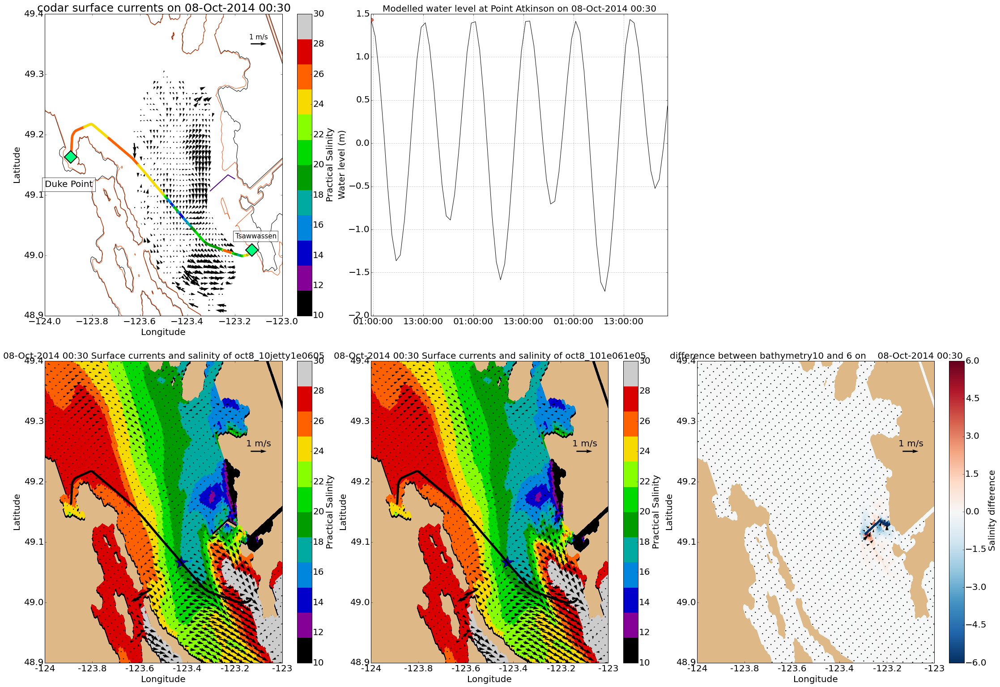

In [14]:
fig = plot_whole(run_time,lon_codar,lat_codar)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 13.081632653061227 degree


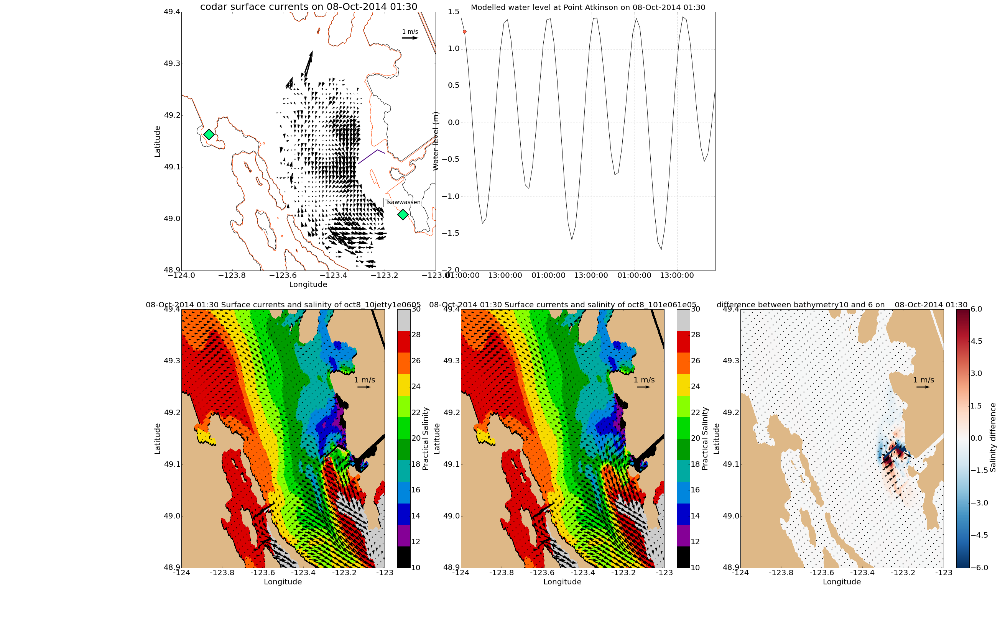

In [15]:
run_time = run_time.replace(hour = 1)
fig = plot_whole(run_time,lon_codar,lat_codar)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 42.46938775510205 degree


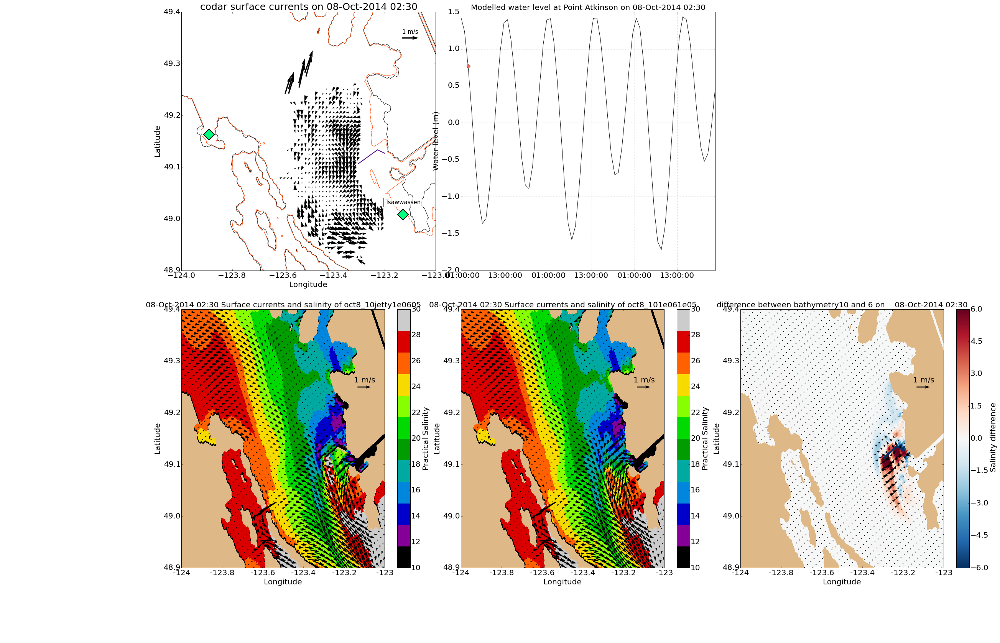

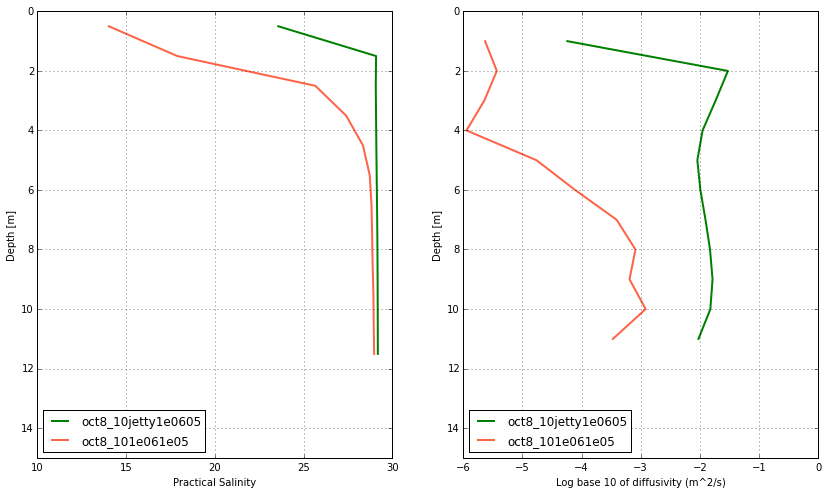

In [16]:
run_time = run_time.replace(hour = 2)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 71.85714285714286 degree


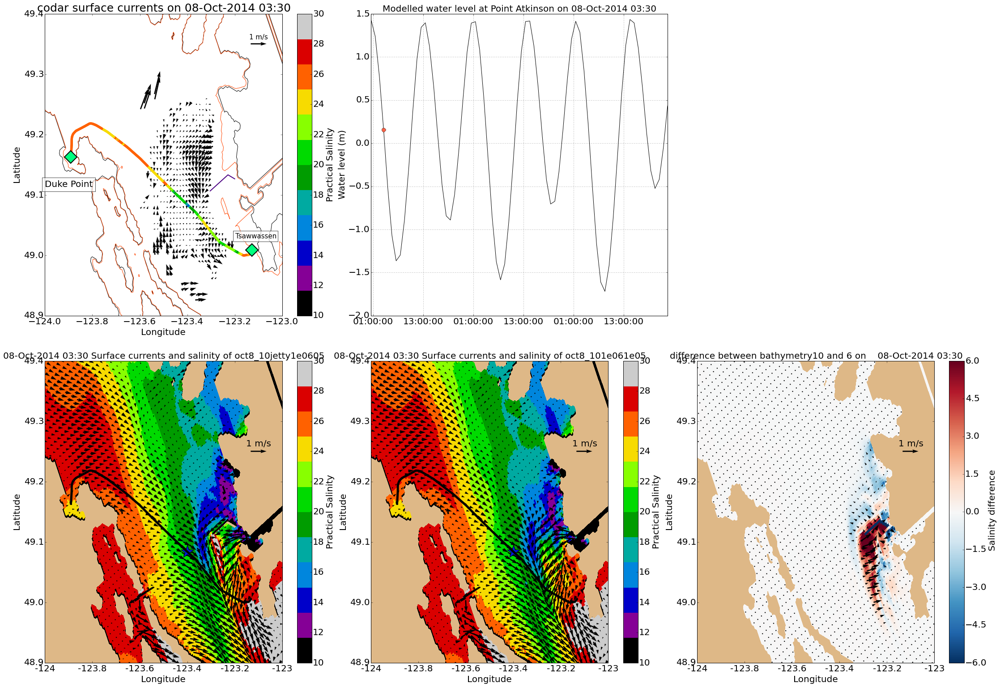

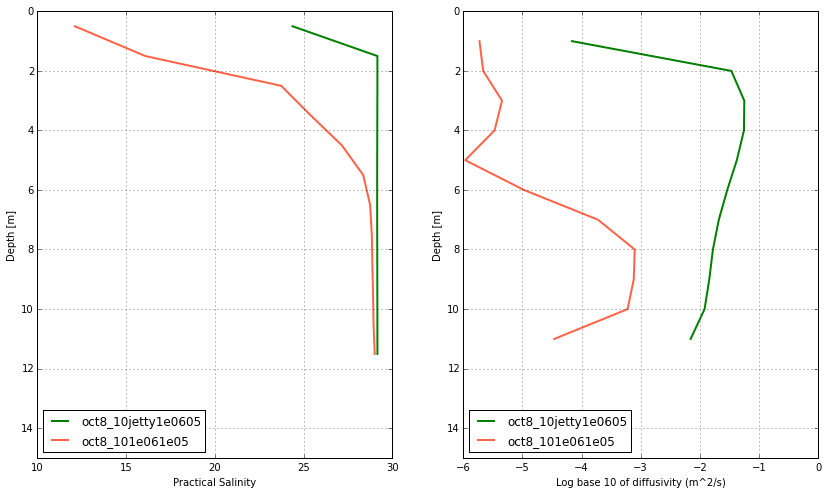

In [17]:
run_time = run_time.replace(hour = 3)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 101.24489795918367 degree


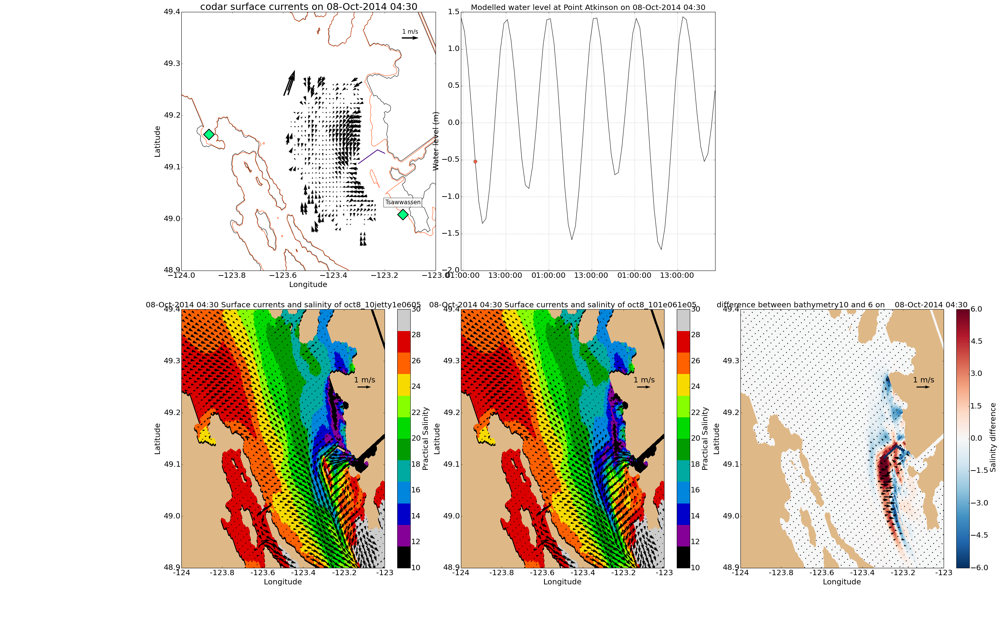

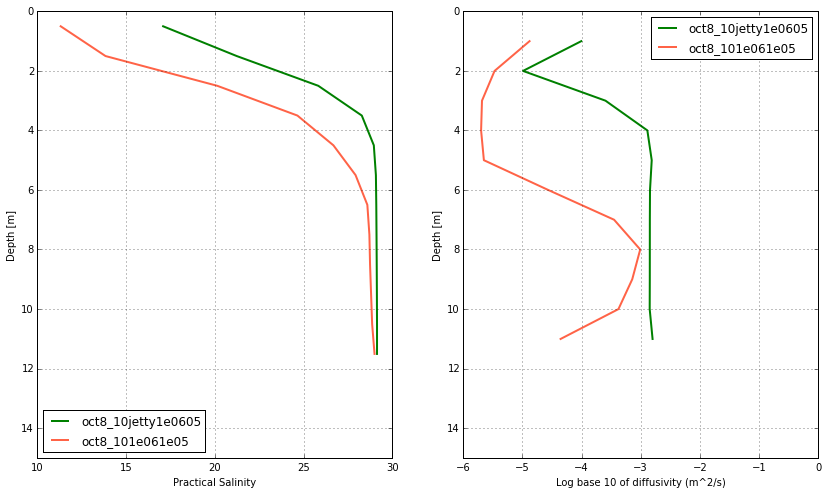

In [18]:
run_time = run_time.replace(hour = 4)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 130.6326530612245 degree


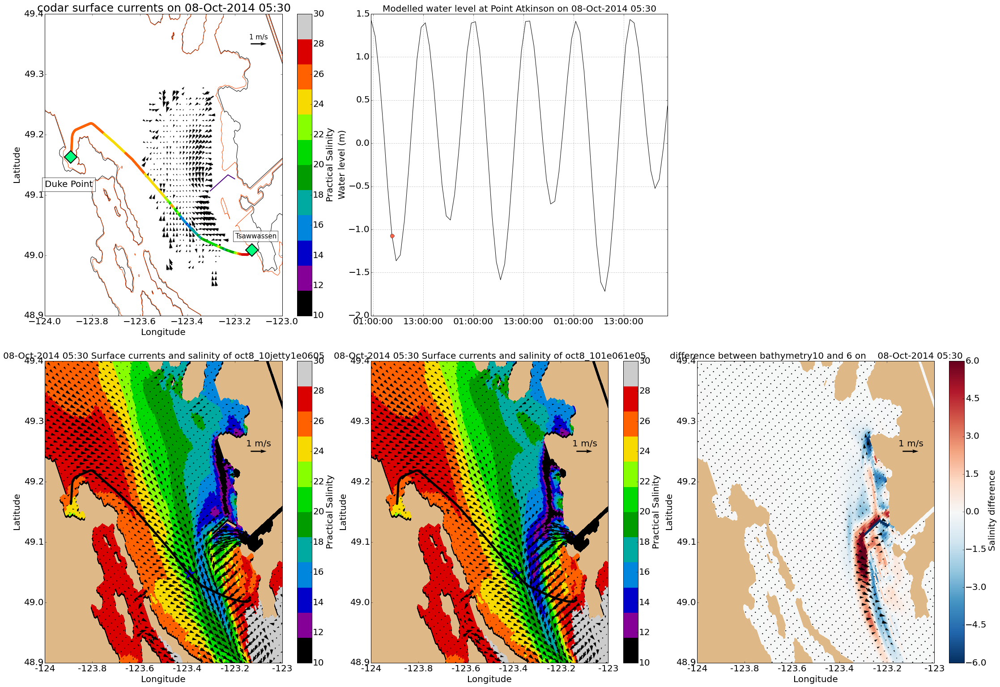

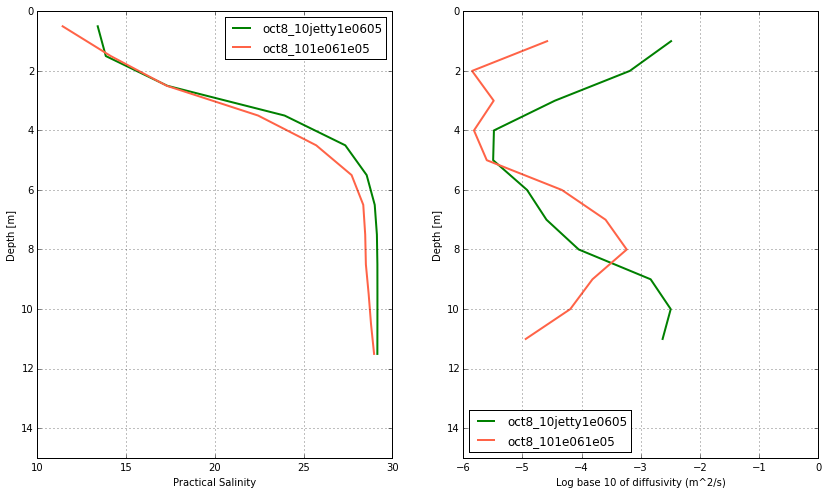

In [19]:
run_time = run_time.replace(hour = 5)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 5.734693877551024 degree


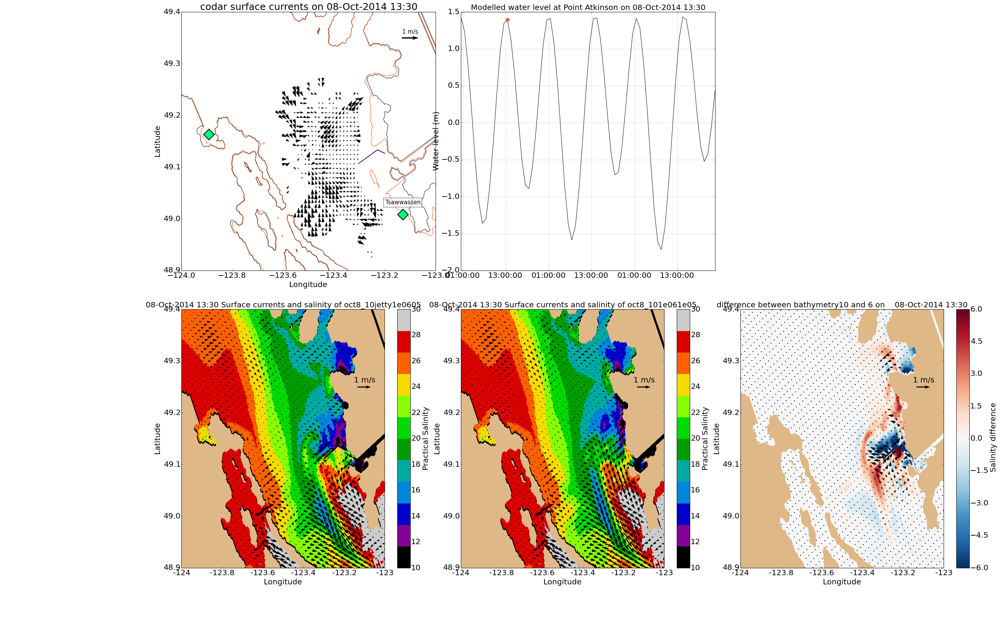

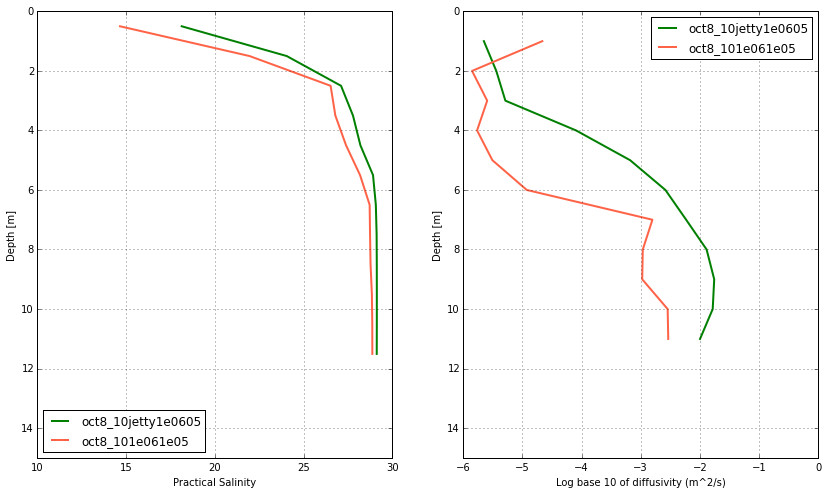

In [20]:
run_time = run_time.replace(hour = 13)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 35.122448979591866 degree


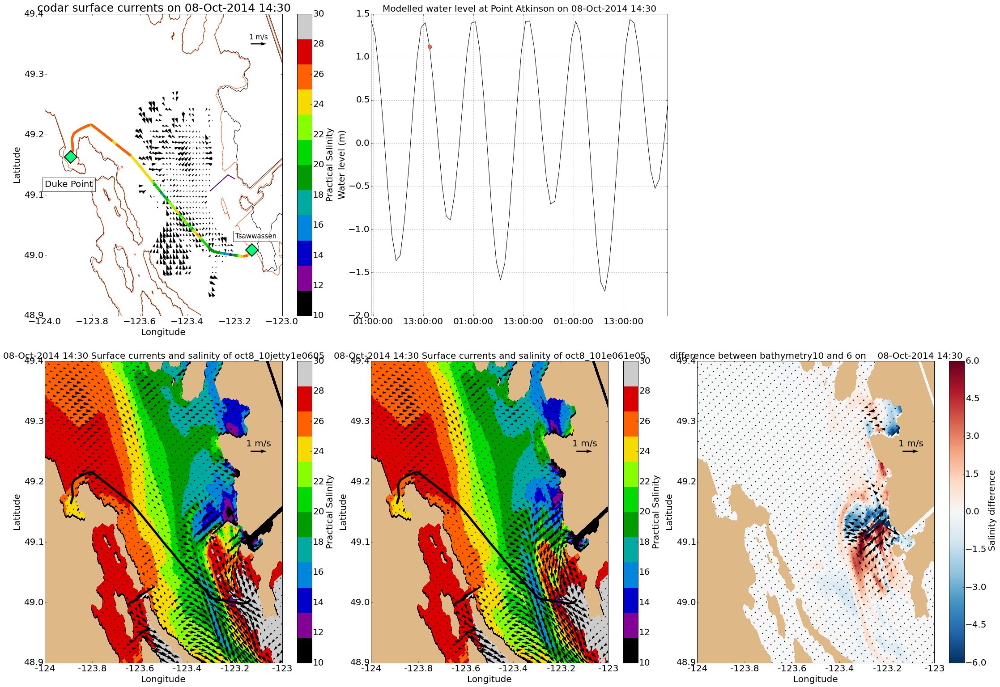

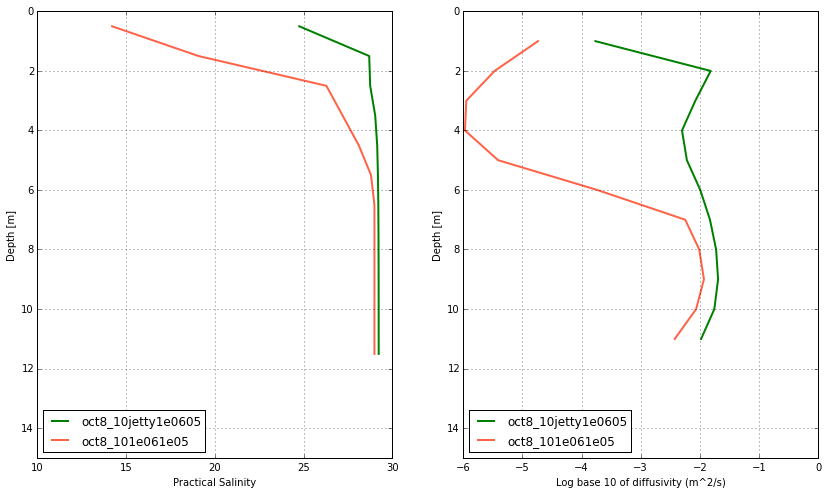

In [21]:
run_time = run_time.replace(hour = 14)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 64.51020408163265 degree


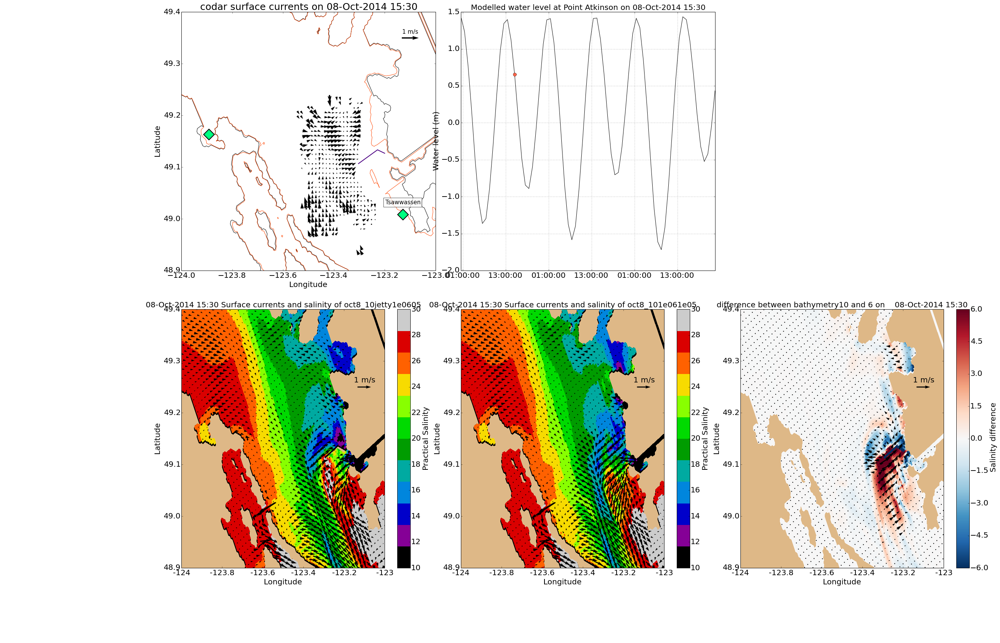

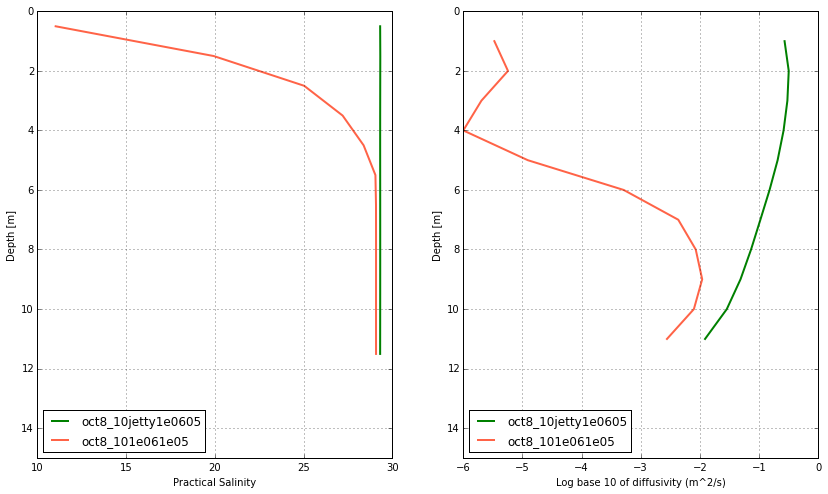

In [22]:
run_time = run_time.replace(hour = 15)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 93.89795918367349 degree


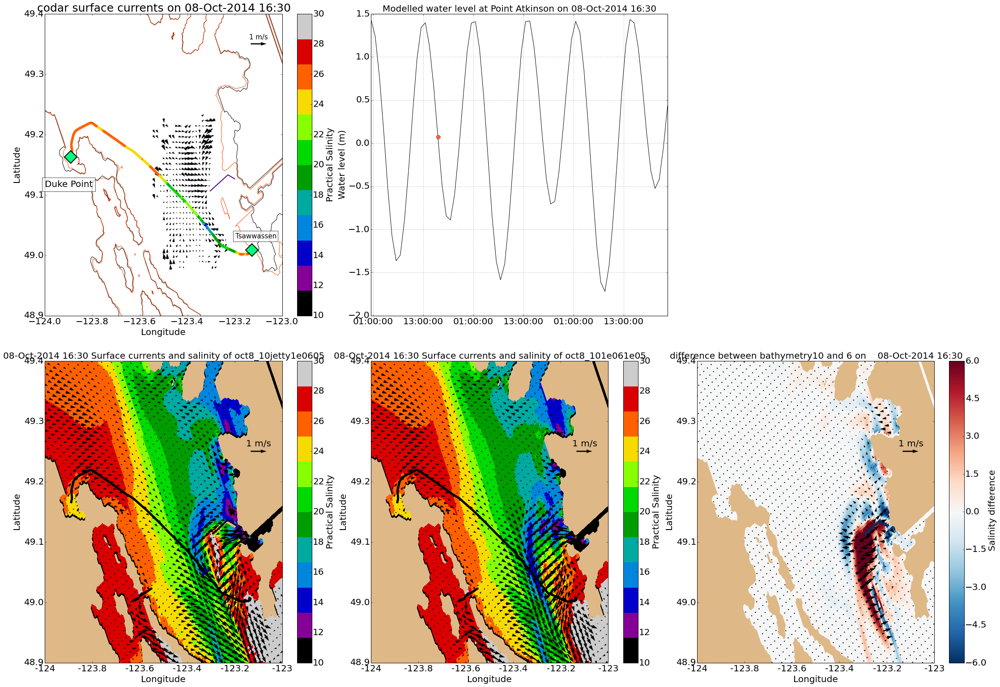

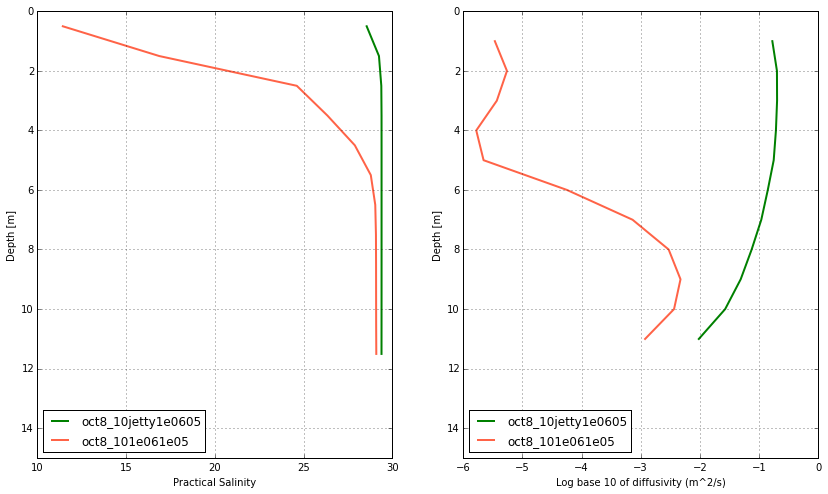

In [23]:
run_time = run_time.replace(hour = 16)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 123.28571428571433 degree


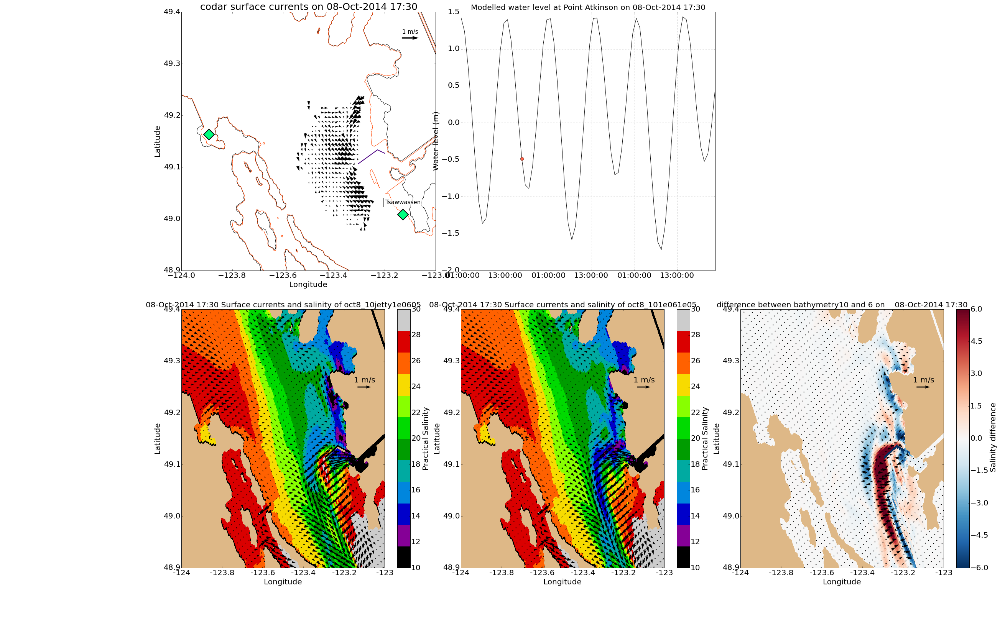

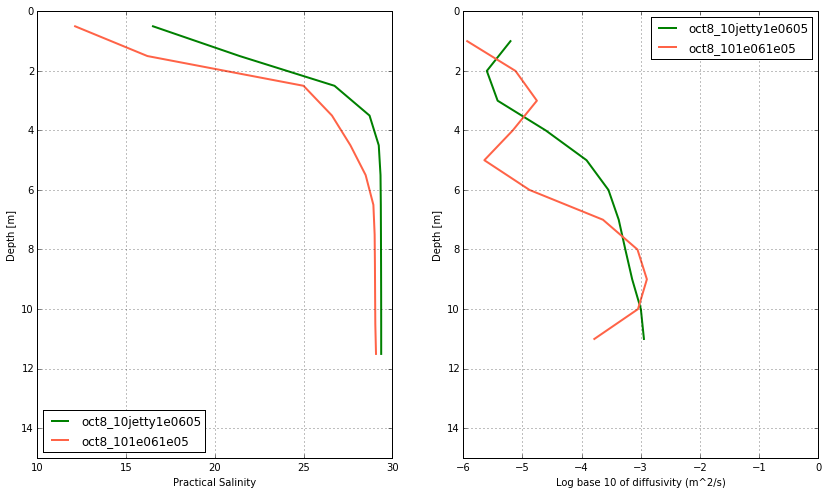

In [24]:
run_time = run_time.replace(hour = 17)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 152.67346938775506 degree


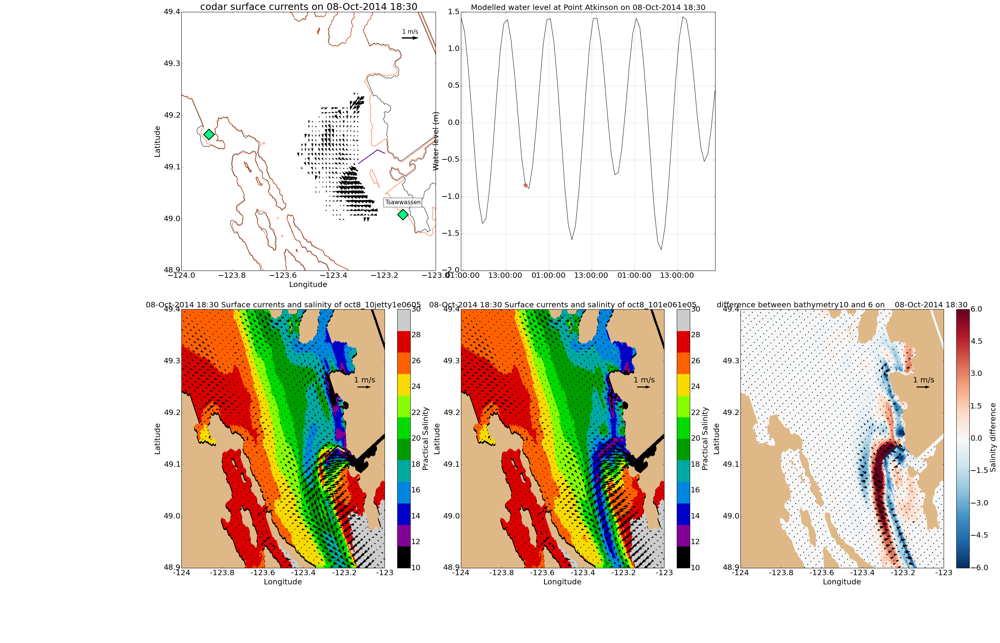

In [25]:
run_time = run_time.replace(hour = 18)
fig = plot_whole(run_time,lon_codar,lat_codar)

   Features of observational data:
* 1) codar: A boundary of currents separation exists, which is located around sandhdeas, below which strong cross strait flow is found during strong ebb tide, above which currents rotate cyclonically. Does this indicate different mechanism cause the different flow features? 
* 2) ferry data: Minimum ferry salinity value ranges between 12~16 during Oct8~10, the locations varied between -123.4~123.2.

  Comparisons between obs and mod:
* 1) Modelled salinity field and currents show more uniform and regular patterns.
* 2) Modelled salinity value of the same minium obs salinity location is 2~5 units saliter than ferry data. But note, time is not accurately corresponds between ferry time and modelled surface current time.

  Comparisons between with jetty & no jetty:
* 1) Jetty blocked freshwater going northward to some extent.
* 2) Saltier water at head of jetty than that without jetty, part of it caused by intense mixing, further look at its mechanism.
* 3) Fresher water in the middle width of strait of jetty case, that indicates more plume going cross the strait.
* 4) Currents in English Bay are strong with jetty case.

* Overall, I think adding jetty into the model is good as shown from HF radar, there is a separation flow in the plume between north and south, and location of jetty is the boundary. That suggests jetty plays a role in the flow separation otherwise, our modelled currents show too uniform and regular patterns.
* Compare max velocity between codar and modelled surface current, modelled is 0.8-2.0 m/s stronger than codar during ebb tide, if that is caused by strong tide-driven flow, or wind-driven flow? Need to check wind and tide then. Always strongest at location -123.349, 48.899, is this true?? Location of max codar currents varied between north and south. I believe some are not reliable as they are probably noise?? 
* Interesting part for vertical mixing region right below edge of the jetty may due to tidal forcing, as it only appears during ebb tide and when it is around turning point from ebb to flood, that region faded. Will further check the phase of the tide when that region shows up. It can be explained as the strong ebb tides going on, the accumulation effect of surface currents in the plume go further southward, that could fill up that vertical mixing region at the surface. Strong vertical eddy diffusivity is, saltier surface layer water will be.

# Oct 9

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: -16.306122448979593 degree


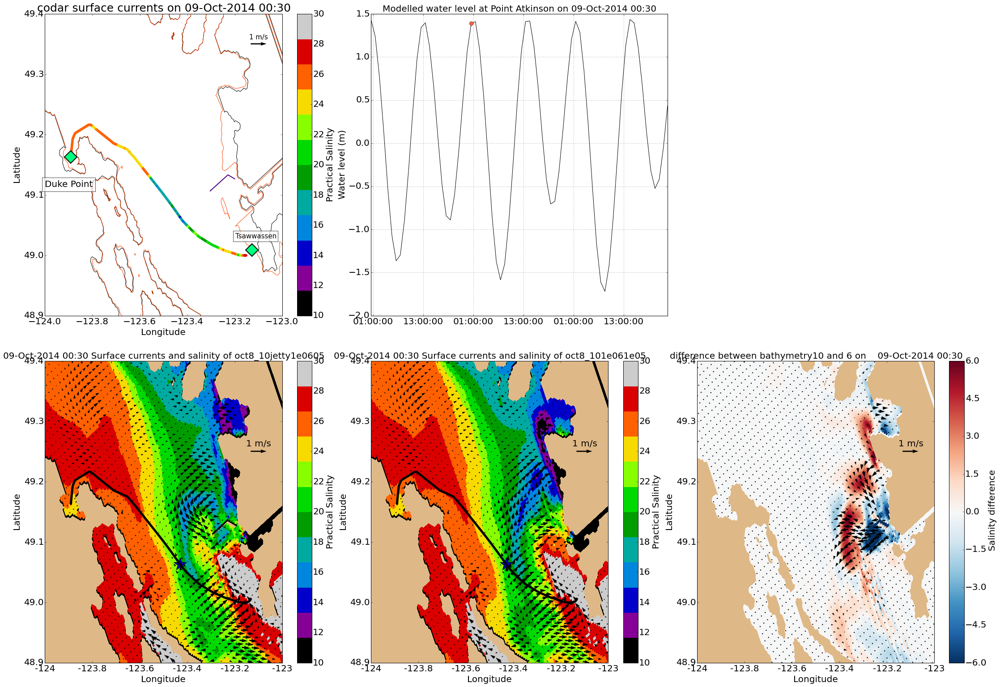

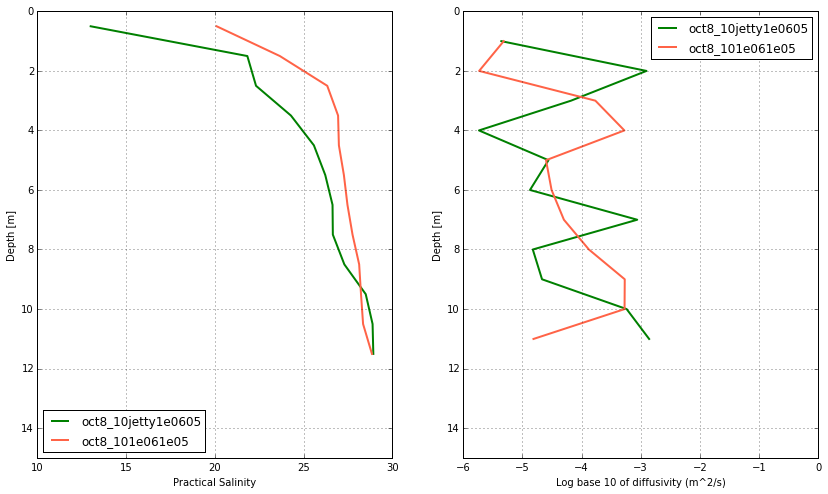

In [26]:
run_time = datetime.datetime(2014, 10, 9, 0)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 13.081632653061227 degree


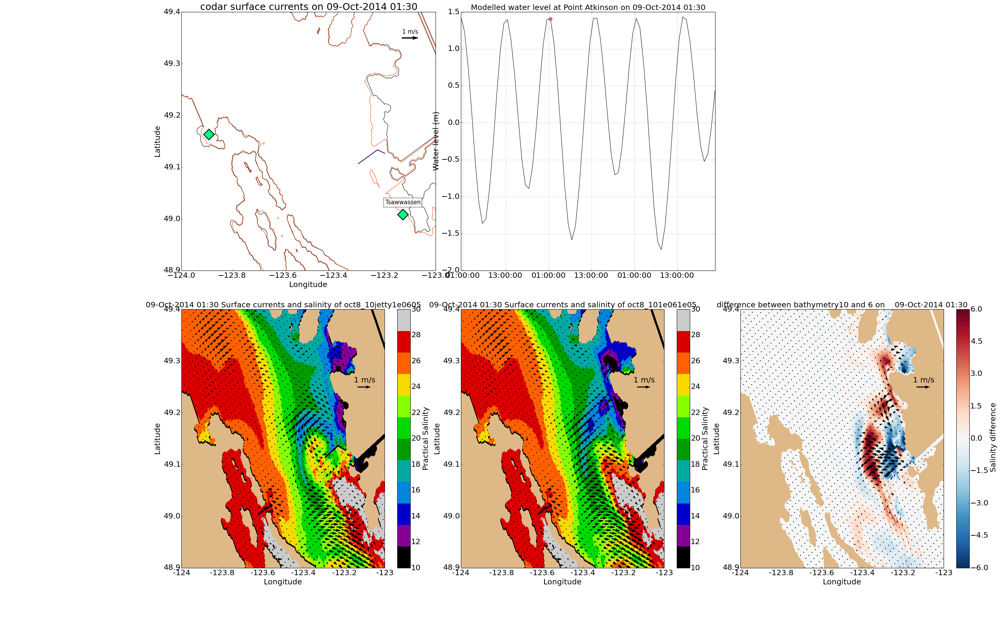

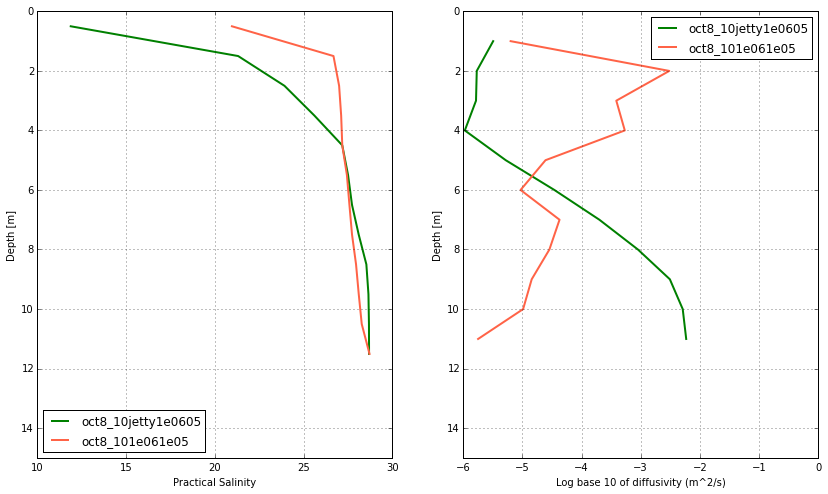

In [27]:
run_time = datetime.datetime(2014, 10, 9, 1)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 42.46938775510205 degree


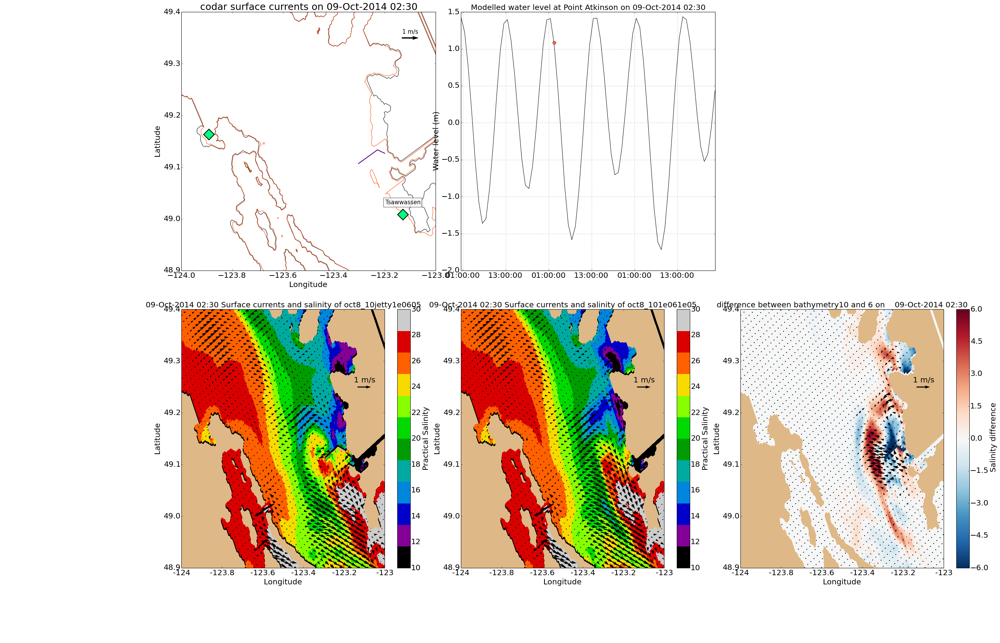

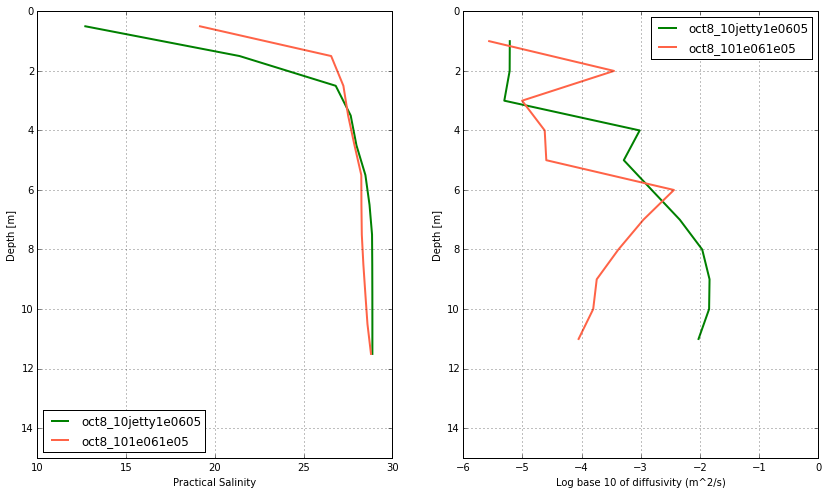

In [28]:
run_time = datetime.datetime(2014, 10, 9, 2)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 71.85714285714286 degree


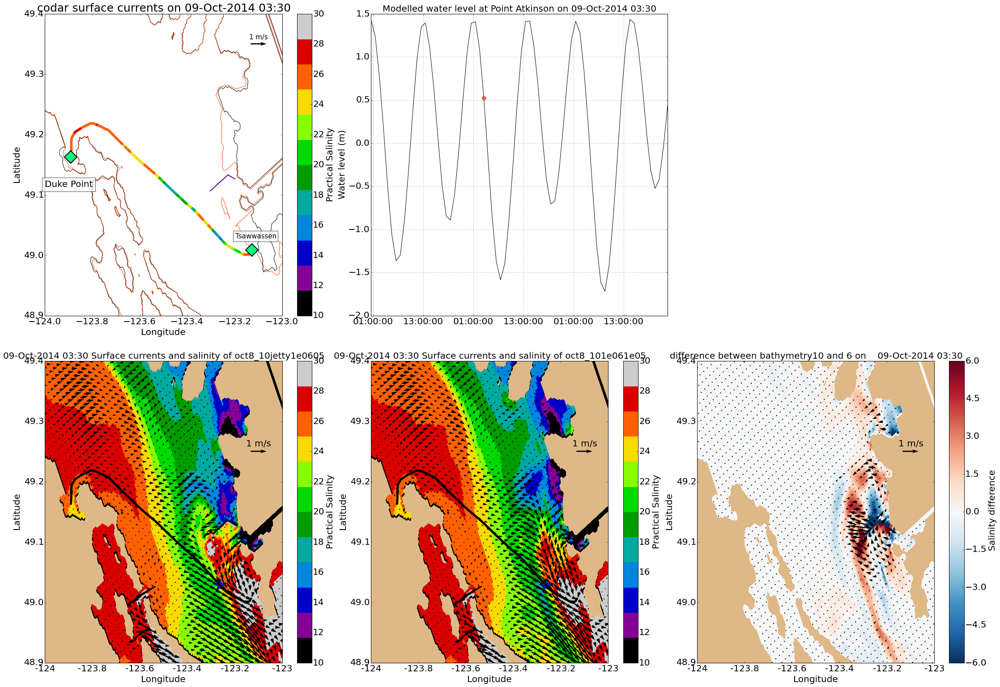

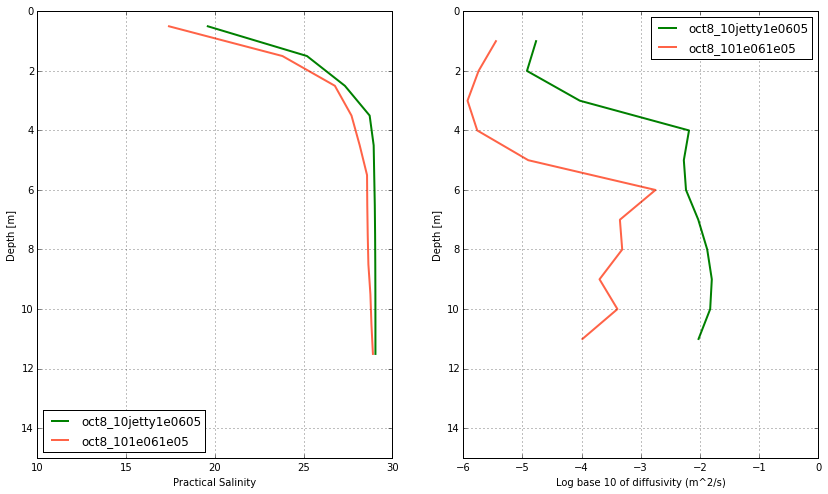

In [29]:
run_time = datetime.datetime(2014, 10, 9, 3)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 101.24489795918367 degree


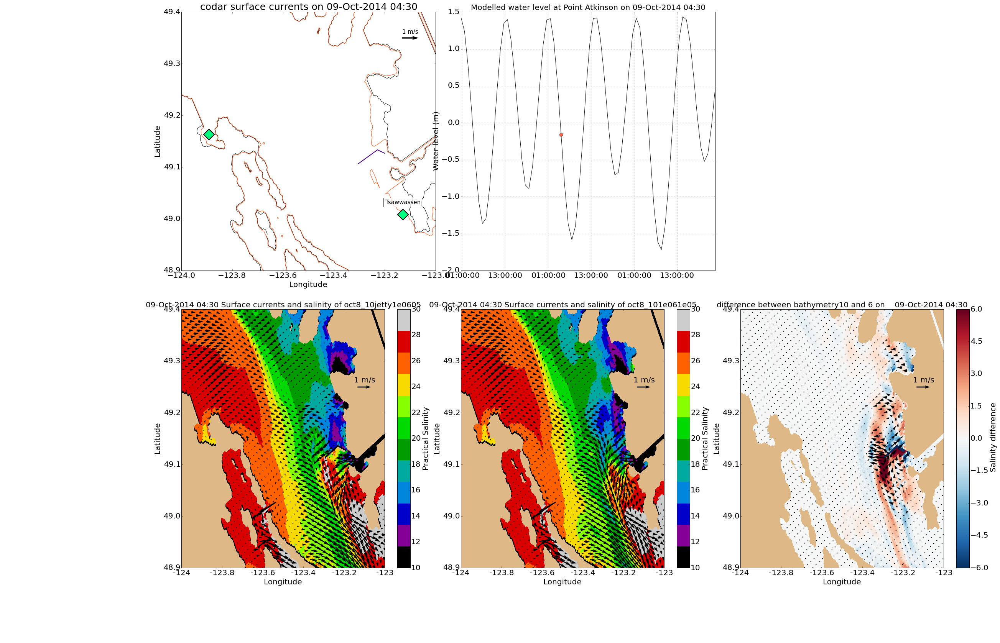

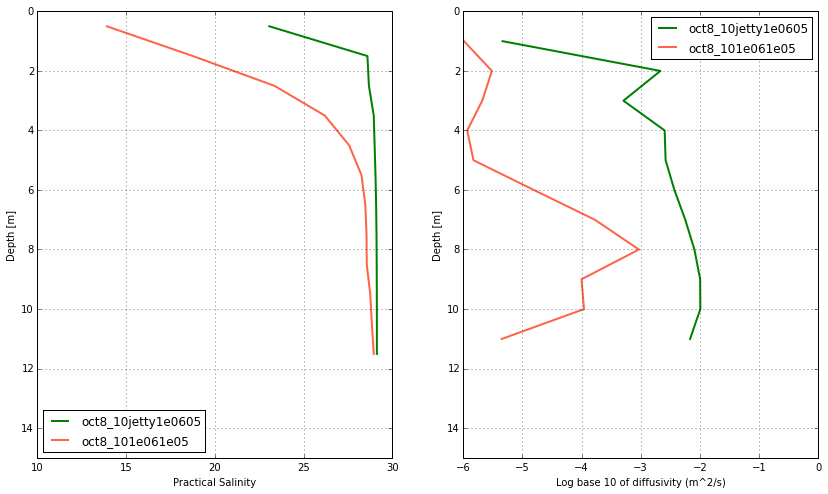

In [30]:
run_time = datetime.datetime(2014, 10, 9, 4)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 130.6326530612245 degree


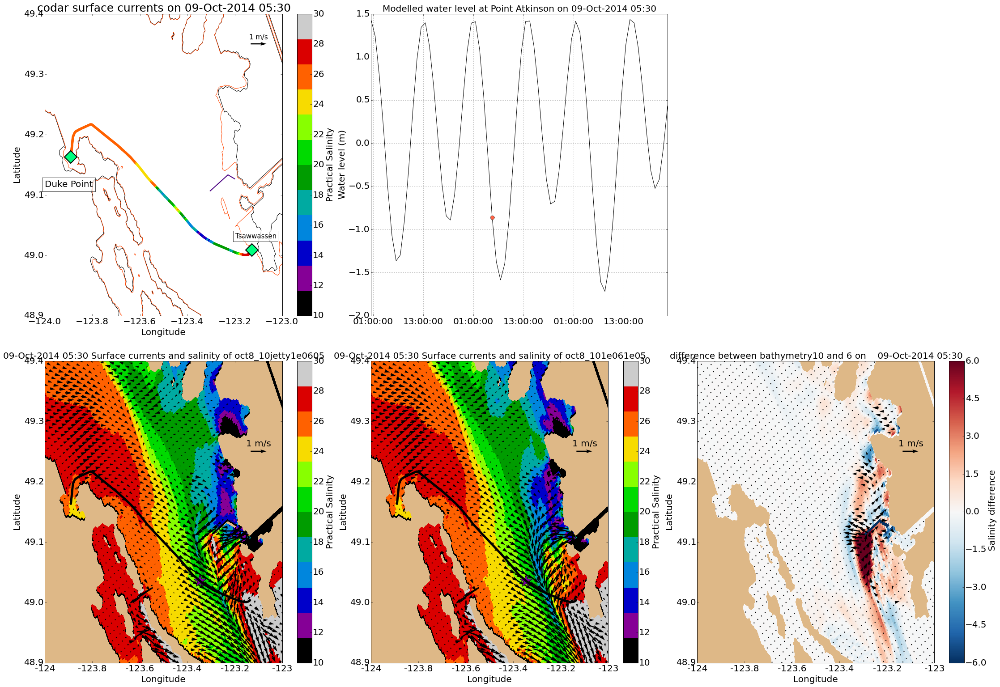

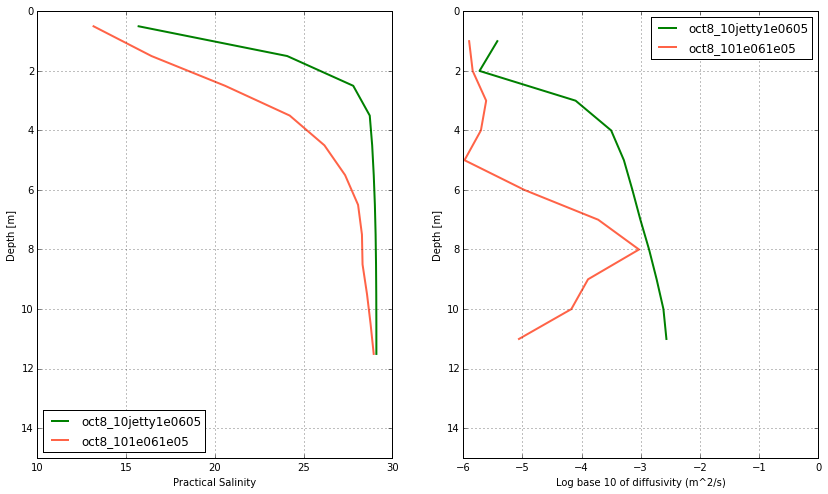

In [31]:
run_time = datetime.datetime(2014, 10, 9, 5)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 160.0204081632653 degree


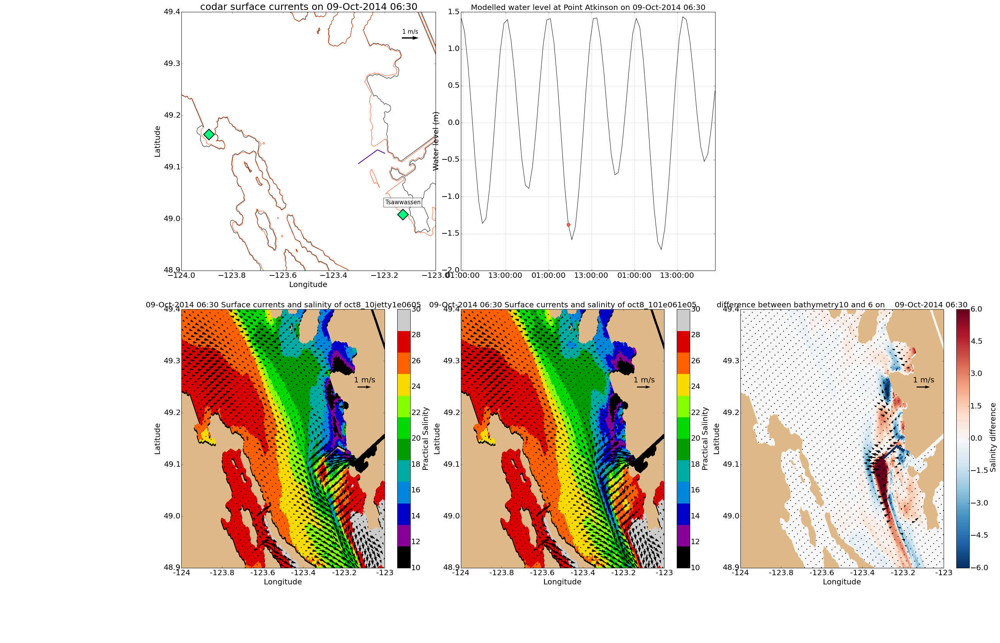

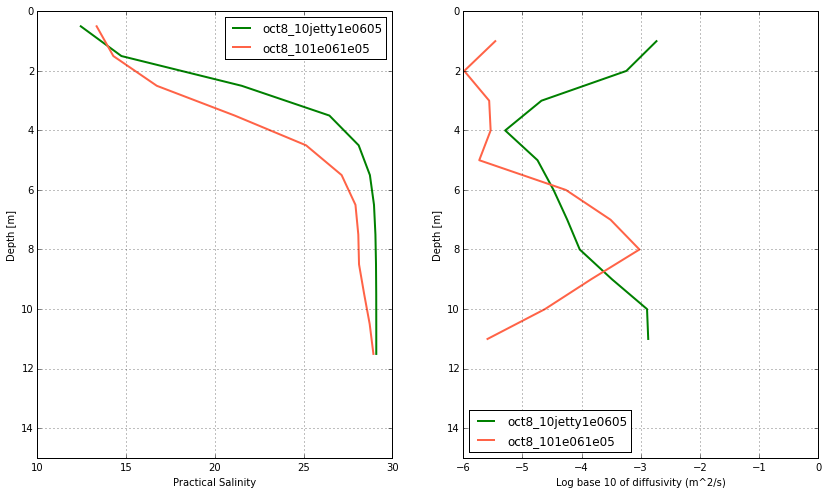

In [32]:
run_time = datetime.datetime(2014, 10, 9, 6)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

# Oct10

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 101.24489795918367 degree


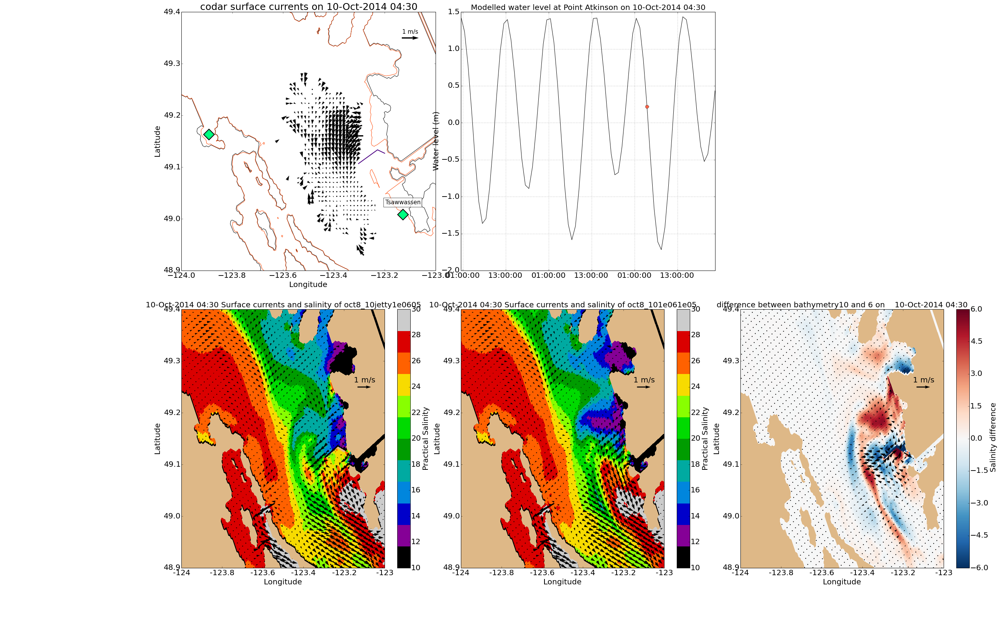

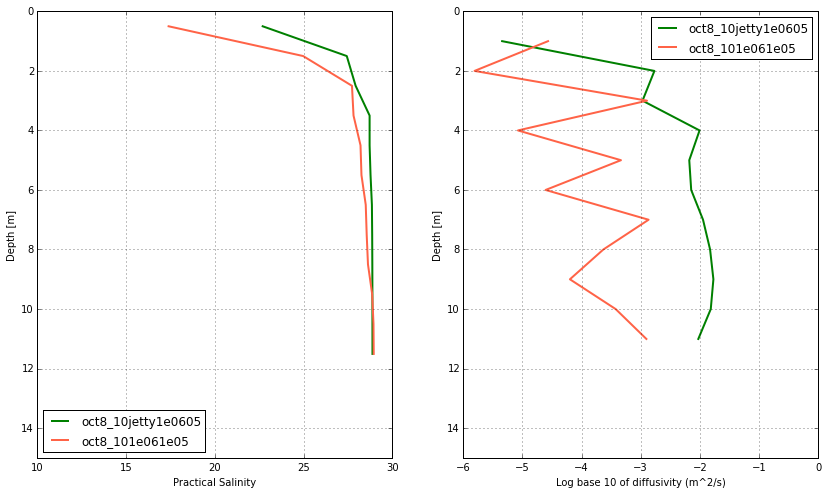

In [33]:
run_time = datetime.datetime(2014, 10, 10, 4)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 130.6326530612245 degree


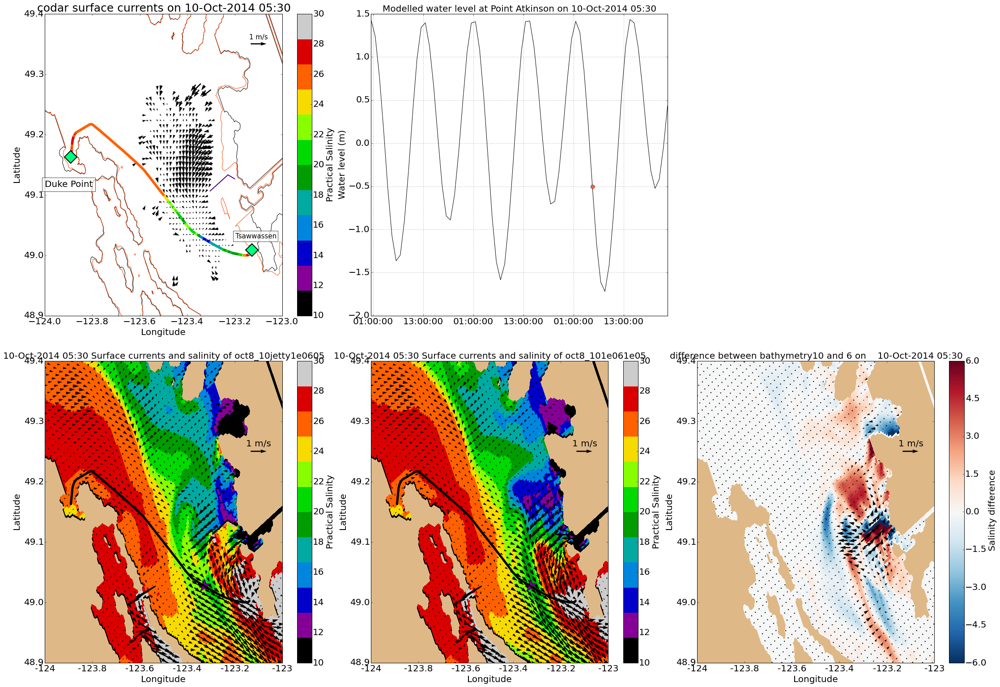

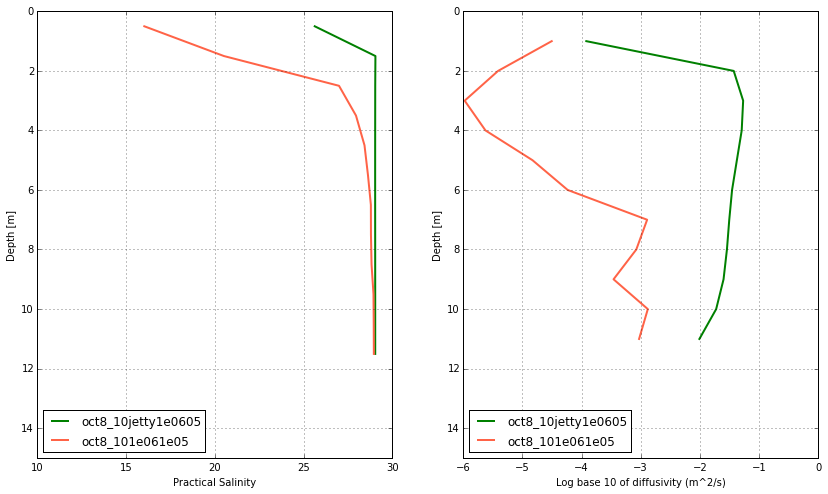

In [34]:
run_time = datetime.datetime(2014, 10, 10, 5)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 160.0204081632653 degree


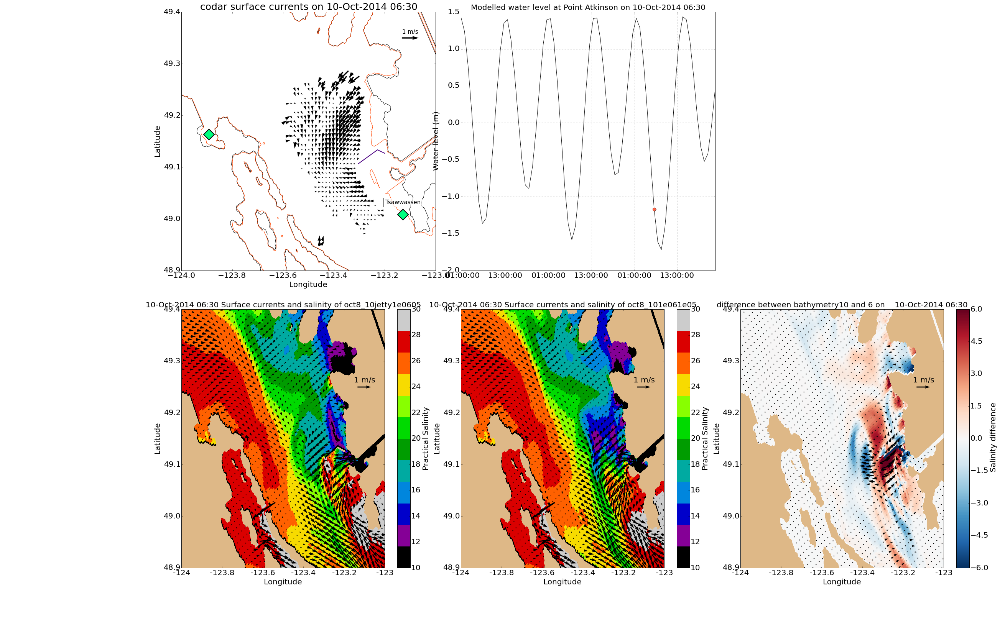

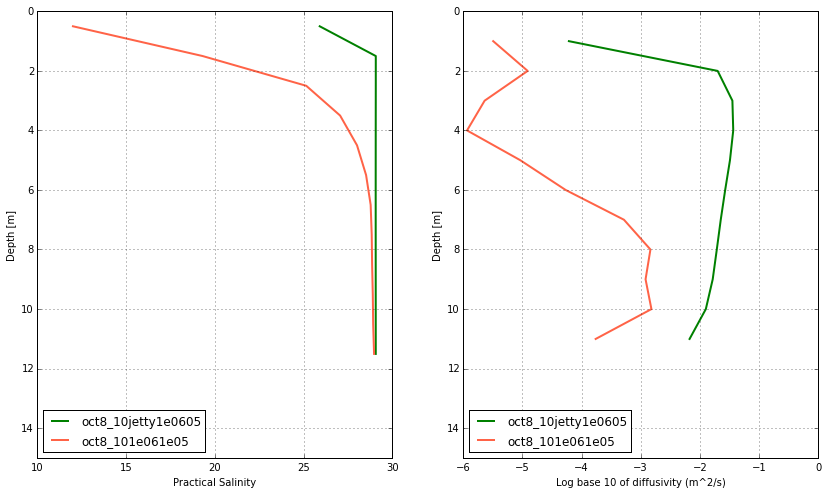

In [35]:
run_time = datetime.datetime(2014, 10, 10, 6)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 189.40816326530611 degree


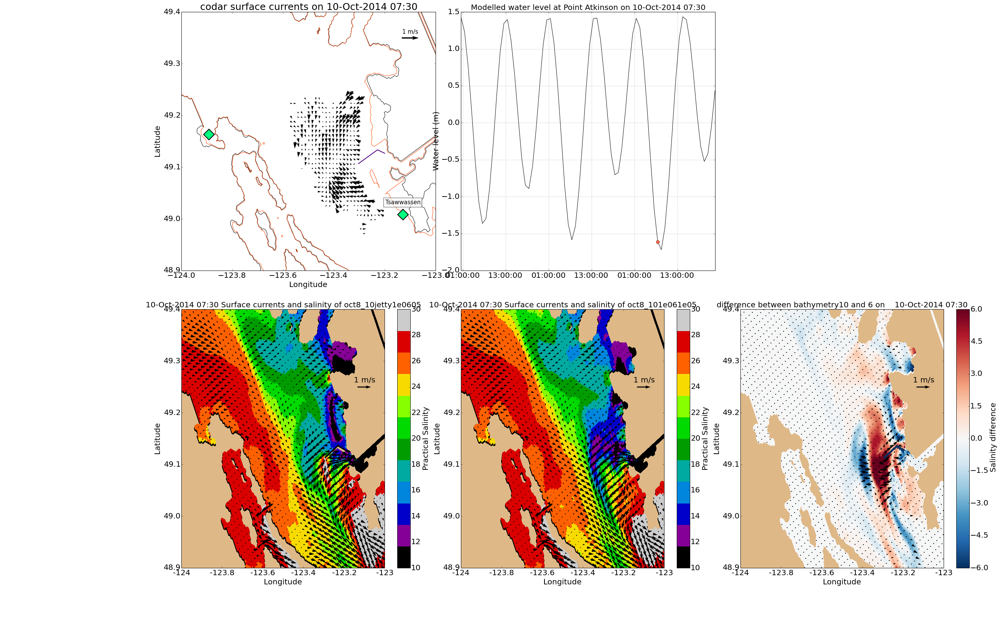

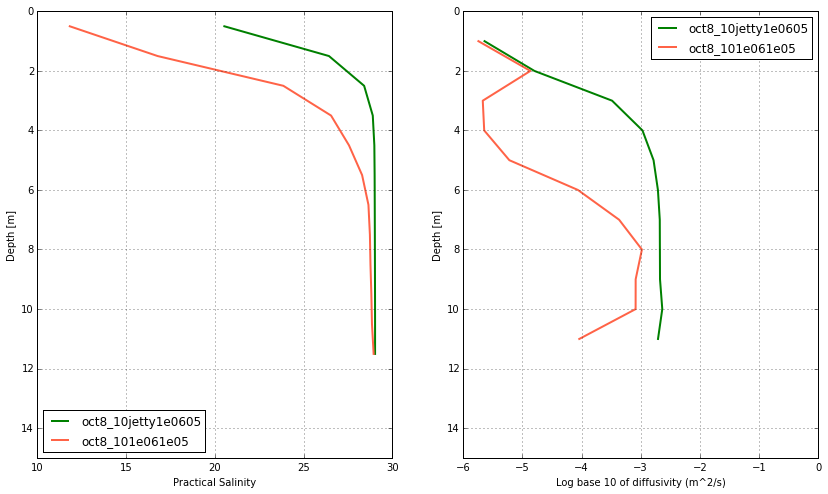

In [36]:
run_time = datetime.datetime(2014, 10, 10, 7)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)

/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:650: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != str('face'):
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/numpy/lib/nanfunctions.py:675: RuntimeWarning: Mean of empty slice
  warnings.warn("Mean of empty slice", RuntimeWarning)
/home/jieliu/anaconda3/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


M2 tidal phase at PA is: 218.79591836734696 degree


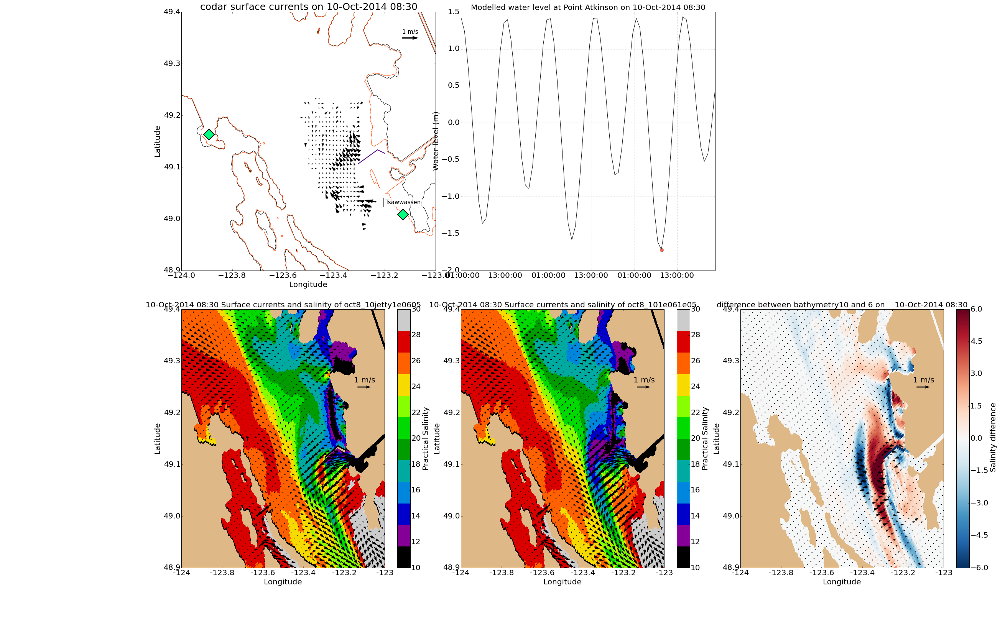

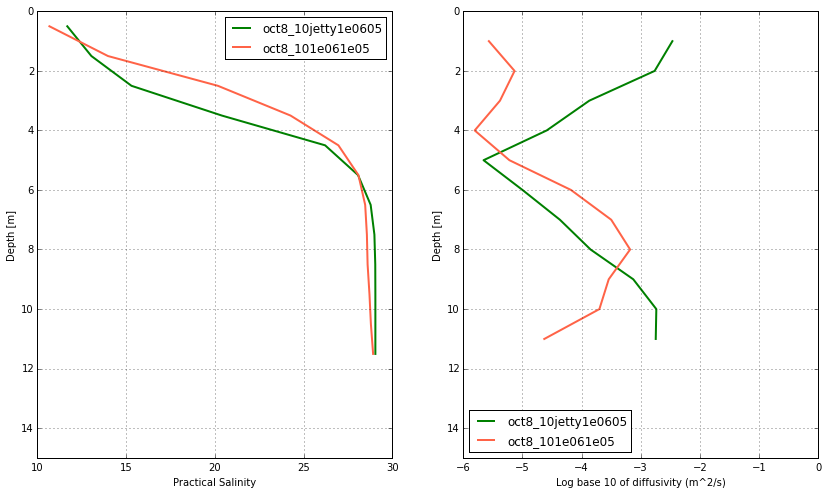

In [37]:
run_time = datetime.datetime(2014, 10, 10, 8)
fig = plot_whole(run_time,lon_codar,lat_codar)
fig = vertical_sal(run_time)